# Taller 4

## Métodos Computacionales 2

Instrucciones: Suba el jupyter notebook **.ipynb** en la actividad de bloque neon. El archivo debe ser nombrado ApellidoNombreApellidoNombre_Taller4.ipynb, con su primer Apellido y Nombre. **El archivo debe poder correr en el binder del curso** 

Si un ejercicio demora **más de 10 segundos** en correr se considerará **incorrecto**.

La simulación no debe demorar más de **50 segundos** en google colab o se considerará incorrecto. 

No modifique el cuaderno, ni los modos de lectura de los archivos.

**Entrega: Sábado 27 de Mayo 11:59 pm**

## Librerias

In [98]:
import time
import numpy as np

import matplotlib.pyplot as plt
from matplotlib import animation
from matplotlib import cm
from matplotlib import colors
plt.style.use('dark_background')

In [99]:
from matplotlib import rc
rc("animation", html = "jshtml")

## Problema 1 (2/5) puntos

Dada la ecuación de onda bidimensional, 

$$ \frac{\partial^2 u}{\partial t^2} =
{c^2} \left(\frac{\partial^2 u}{\partial x^2} + \frac{\partial^2 u}{\partial y^2} \right)$$

Demuestre que la solución de la ecuación de onda bidimensional con diferencias finitas para extremos fijos está dada por, 

$$
u^1_{i, j} = \frac{a}{2}u^0_{i, j} + V^0_{i, j}\Delta t + \frac{r_x}{2}(u^0_{i+1, j} + u^0_{i-1, j}) + \frac{r_y}{2}(u^0_{i, j+1}+u^0_{i, j-1})
$$

$$
u^{n+1}_{i, j} = au^n_{i, j} - u_{i, j}^{n-1} + r_x(u^n_{i+1, j} + u^n_{i-1, j}) + r_y(u^n_{i, j+1}+u^n_{i, j-1})
$$

Donde, 

$$
r_x = (\Delta t)^2c^2/(\Delta x)^2, \quad r_y = (\Delta t)^2c^2/(\Delta y)^2
$$

$$
a = 2(1 - r_x - r_y)
$$

Su demonstración aquí, 


Ecuación diferencial de onda bidimensional:
$$\frac{\partial^2 u}{\partial t^2} = c^2 \nabla^2 u$$ 

Derivadas discretas de $n$ en el tiempo, $i$ en $x$, y $k$ en $y$:
$$\frac{u_{i,k}^{n+1} - 2u_{i,k}^{n} + u_{i,k}^{n-1}}{\left( \Delta t \right)^{2}} = c^{2} \left[ \frac{u_{i+1,k}^{n} - 2u_{i,k}^{n} + u_{i-1,k}^{n}}{\left( \Delta x \right)^{2}} + \frac{u_{i,k+1}^{n} - 2u_{i,k}^{n} + u_{i,k-1}^{n}}{\left( \Delta y \right)^{2}}\right]$$

Productos de $\Delta$:
$$r_x = \left[ \frac{c \Delta t}{\Delta x} \right]^2$$
$$r_y = \left[ \frac{c \Delta t}{\Delta y} \right]^2$$

$$u_{i,k}^{n+1} - 2 u_{i,k}^n + u_{i,k}^{n-1} = r_{x} \left[ u_{i+1,k}^{n} - 2 u_{i,k}^n + u_{i-1,k}^n\right] +r_y \left[ u_{i,k+1}^{n} - 2 u_{i,k}^n + u_{i,k-1}^n\right]$$

$\textbf{1.}$ Si $n=0$:
$$u_{i,k}^1 - 2u_{i,k}^0 + u_{i,k}^{-1} = r_x \left[ u_{i+1,k}^0 -2 u_{i,k}^0 + u_{i-1,k}^0 \right] + r_y \left[ u_{i,k+1}^0 -2 u_{i,k}^0 + u_{i,k-1}^0 \right] $$

Como $t>0$:
$$\frac{u_{i,k}^1 - u_{i,k}^{-1}}{2 \Delta t} = V_{i,k}^0$$

$V_{i,k}^0$ es una condición inicial, al reemplazar:
$$-u_{i,k}^1 + 2 u_{i,k}^0 - \left[ u_{i,k}^1 - 2 \Delta t V_{i,k}^0 \right] = -r_x \left[ u_{i+1,k}^0 - 2u_{i,k}^0 + u_{i-1,k}^0 \right] - r_y \left[ u_{i,k+1}^0 - 2 u_{i,k}^0 + u_{i,k-1}^0 \right]$$
$$-2  u_{i,k}^1 = -2 u_{i,k}^0 + 2 r_x u_{i,k}^0 + 2 r_y u_{i,k}^0 - 2 \Delta t V_{i,k}^0 - r_x \left[ u_{i+1,k}^0 + u_{i-1,k}^0 \right] - r_y \left[ u_{i,k+1}^0 + u_{i,k-1}^0 \right]$$

Si $a=2\left( 1- r_x - r_y \right)$ :
$$-2 u_{i,k}^1 = -a u_{i,k}^0 - 2 \Delta t V_{i,k}^0 - r_x \left[u_{i+1,k}^0 + u_{i-1,k}^0 \right] - r_y \left[u_{i,k+1}^0 + u_{i,k+1}^0 \right]$$
$$u_{i,j}^1 = \frac{a}{2} u_{i,j}^0 + V_{i,j}^0 \Delta t + \frac{r_x}{2} \left[ u_{i+1,j}^0 + u_{i-1,j}^0 \right] + \frac{a}{2} u_{i,j}^0 + V_{i,j}^0 \Delta t + \frac{r_y}{2} \left[ u_{i,j+1}^0 + u_{i,j-1}^0 \right]$$

$\textbf{2.}$ Despejando:
$$u_{i,k}^{n+1} - 2 u_{i,k}^n + u_{i,k}^{n-1} = r_x \left[ u_{i+1,k}^n - 2 u_{i,k}^n + u_{i-1,k}^n \right] + r_y \left[ u_{i,k+1}^n - 2 u_{i,k}^n + u_{i,k-1}^n \right]$$
$$u_{i,k}^{n+1} = 2 u_{i,k}^n + u_{i,k}^{n-1} + r_x \left[ u_{i+1,k}^n - 2 u_{i,k}^n + u_{i-1,k}^n \right] + r_y \left[ u_{i,k+1}^n - 2 u_{i,k}^n + u_{i,k-1}^n \right]$$

Como $a=2\left( 1- r_x - r_y \right)$ :
$$u_{i,k}^{n+1} = a u_{i,k}^n - u_{i,k}^{n-1} + r_x \left[ u_{i+1,k}^n + u_{i-1,k}^n \right] + r_y \left[ u_{i,k+1}^n + u_{i,k+1}^n \right]$$


## Problema 2 (3/5) Puntos

Solucionar la ecuación de onda bidimensional con extremos fijos en cero para la posición inicial $p(x,y)$.

$$p(x,y) = \frac{1}{\sqrt{\sigma}} e^{\left( -{\frac{(x-0.5)^{2} +(y-0.5)^{2}}{\sigma^{2}}} \right)}$$

con $\sigma = 0.1$, en el dominio $x \in [0, 1]$,  $y \in [0, 1]$ y velocidad inicial de cada nodo igual a cero para $t=0$. Use los valores de la tabla. Realice una animación en perspectiva 3D, para que la simulación no demore tanto realice la simulación con solo las imagenes de cada $50*dt$. Use el siguiente [notebook](https://github.com/diegour1/MetodosComputacionales2/blob/main/Notebooks/11%20-%20ecuacion_onda_1D.ipynb) como guía. 

**Tabla:**

|  |                                        |
|-----------------------|----------------------------------------|
| $$c$$                 |                                $$1.8$$ |
| $$dx$$                |                               $$0.05$$ |
| $$dy$$                |                               $$0.05$$ |
| $$t_{total}$$           |                                  $$0.5$$ |
| $$dt$$                | $$\frac{1}{10c}\frac{dx^2dy^2}{dx^2+dy^2}$$ |

En la calificación el notebook se correra en Google Colab, de cualquier forma adjunte la animación en un video de youtube público, debe obtener un video como el que se muestra,

Cambie este link por su video de youtube, 

Espacio para el video de youtube

https://youtu.be/e7X2QVmlwM4

In [100]:
sigma = 0.1
c = 1.8
L = 1
dx, dy = 0.047, 0.047
lx, ly = 1.0, 1.0
t_total = 0.5
dt = (1/(10*c)) * (((dx**2)*(dy**2))/((dx**2)+(dy**2)))
l0, lL, lT, lB = 0.0, 1.0, 1.0, 0.0

In [101]:
def pos_ini(x,y):
  return (1.0 / np.sqrt(sigma)) * np.exp(-((x - 0.5)**2 + (y - 0.5)**2) / sigma**2)

def vel_ini(x,y):
  return np.zeros([len(x),len(y)])

def solucion_ecuacion_onda_2D(dx, dy, t_max, L, c, l0, lL):

  rx = (c*dt/dx)**2
  ry = (c*dt/dy)**2

  a = 2*(1-rx-ry)

  x = np.linspace(0, L, num = 1+int(np.round((L)/dx)))
  y = np.linspace(0, L, num = 1+int(np.round((L)/dy)))

  x, y = np.meshgrid(x, y)

  lt = 1+int((t_max)/dt)
  lx = len(x)
  ly = len(y)

  U = np.zeros([lt,lx,ly])
  U[0] = pos_ini(x, y)

  U[:, 0, :] = l0
  U[:, -1, :] = lL
  U[:, :, 0] = l0
  U[:, :, -1] = lL
  
  v0 = vel_ini(x,y)

  U[1,:,:] = U[0,:,:] + dt*v0 

  for n in range(1, lt-1):
    for i in range(1, lx-1):
      for j in range(1, ly-1):
        U[n+1,i,j] = a*U[n,i,j] - U[n-1,i,j] + rx*(U[n,i+1,j]+U[n,i-1,j]) + ry*(U[n,i,j+1]+U[n,i,j-1])

  return x, y, U

In [102]:
start_time = time.time()
x, y, U = solucion_ecuacion_onda_2D(dx, dy, t_total, L, c, 0, 0)

print(f"Tiempo usado en calcular la solución: {time.time()-start_time} (s)")
print(f"x.shape:{x.shape}, y.shape:{y.shape} Ux.shape:{U.shape}")

Tiempo usado en calcular la solución: 6.008661270141602 (s)
x.shape:(22, 22), y.shape:(22, 22) Ux.shape:(8149, 22, 22)


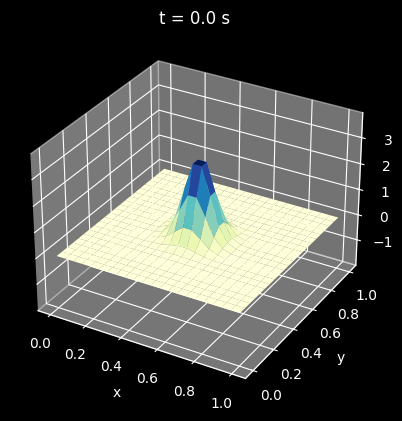

In [103]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

def update(frame):
    ax.clear()
    ax.set_title(f't = {round(frame*dt,2)} s')
    ax.set_zlim3d(np.min(U)-1, np.max(U)+1)

    ax.set_xlabel('x')
    ax.set_ylabel('y')
    ax.set_zlabel('z')

    ax.plot_surface(x, y, U[frame], cmap='YlGnBu')

    return ax

animation.FuncAnimation(fig, update, frames=range(0, int(t_total / dt), 50), interval=50)

#ani = animation.FuncAnimation(fig, update, frames=range(0, int(t_total / dt), 50), interval=50)
#ani.save("punto2.gif", fps=30)

In [104]:
print(f"Tiempo usado en crear la animación: {time.time()-start_time} s")

Tiempo usado en crear la animación: 41.33364939689636 s
